## Load data and libs

In [ ]:
!pip install -q face_recognition
!pip install -q fer
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
import matplotlib.patches as patches
%matplotlib inline
import face_recognition
import numpy as np
from PIL import ImageDraw
import PIL.Image
from io import BytesIO
from fer import FER
import cv2
import operator
import time
from google.colab import files
from google.colab.patches import cv2_imshow
detector = FER()

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Upload image with faces

In [ ]:

uploaded = files.upload() #https://unsplash.com/photos/1qfy-jDc_jo

Saving family.jpg to family.jpg


## Show image

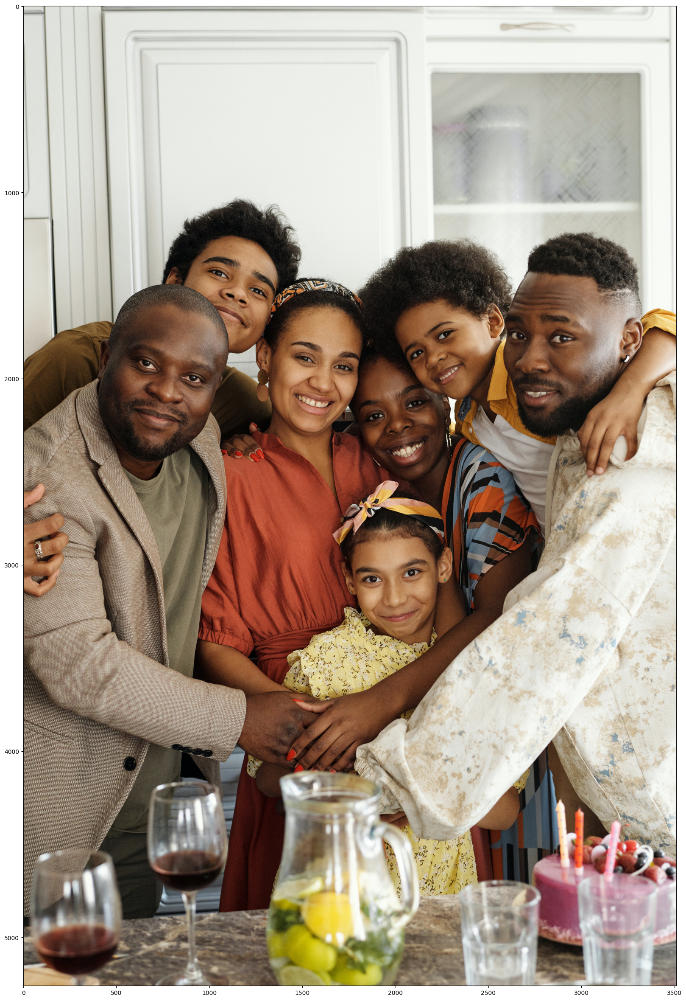

In [ ]:

image = face_recognition.load_image_file(list(uploaded.keys())[0])
boundary = 24
im = PIL.Image.open(list(uploaded.keys())[0])
height = (im.size[1] / im.size[0]) * 20
fig=plt.subplots(figsize=(20,height))
imshow(im)

## Use face_recognition to draw red rectangles around faces

Number of faces: 7
Time taken: 19.8  seconds


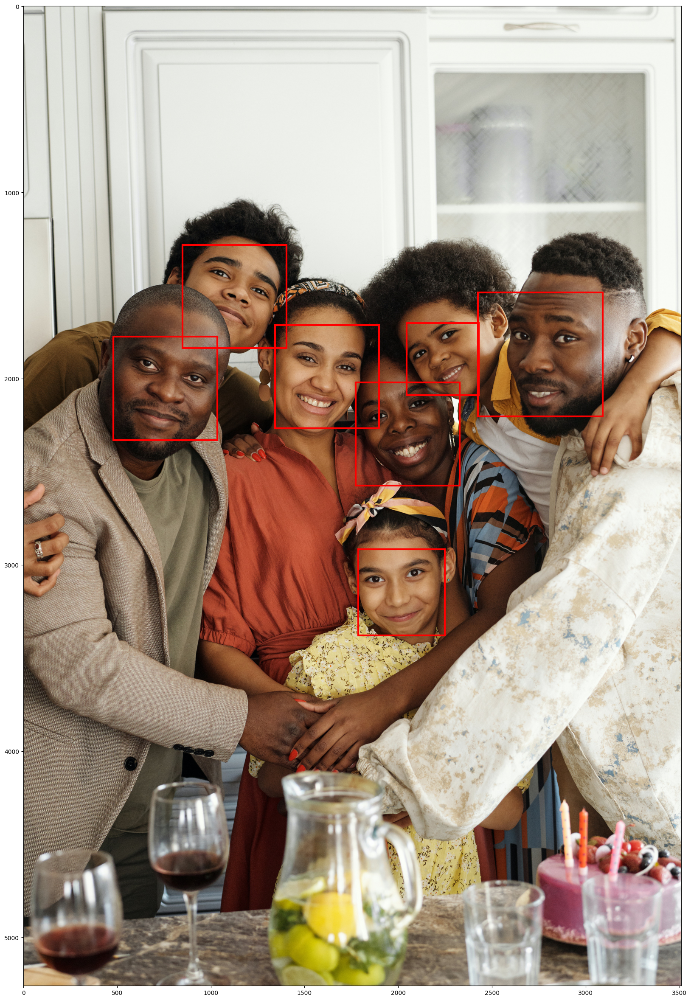

In [ ]:
start = time.time()
face_locations = face_recognition.face_locations(image)
fig,ax = plt.subplots(figsize=(20,height))
for face_location in face_locations:
    top, right, bottom, left = face_location
    ax.imshow(im,aspect='auto')
    rect = patches.Rectangle((left,top), (right - left), (bottom-top),linewidth=3,edgecolor='r',facecolor='none')
    ax.add_patch(rect)
end = time.time()
print("Number of faces:",len(face_locations))
print("Time taken:",round(end-start,2)," seconds")

## Use face_recognition to detect face and classify emotions

Number of faces: 7
Time taken: 19.28009057044983  seconds


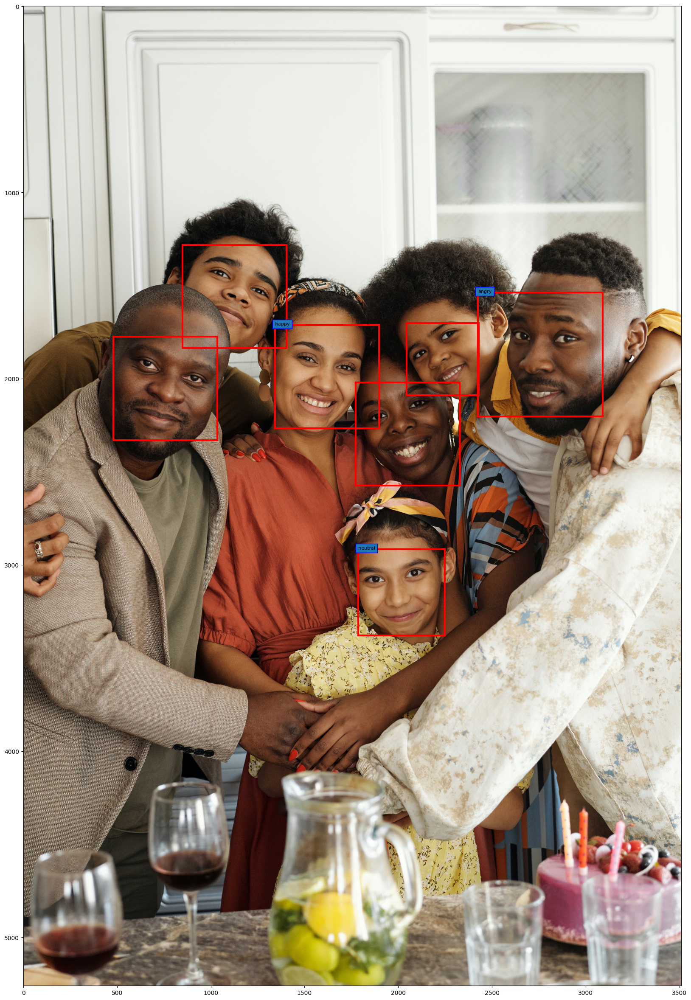

In [ ]:
start = time.time()
face_locations = face_recognition.face_locations(image)
fig,ax = plt.subplots(figsize=(20,height))
for face_location in face_locations:
    top, right, bottom, left = face_location
    ax.imshow(im,aspect='auto')
    rect = patches.Rectangle((left,top), (right - left), (bottom-top),linewidth=3,edgecolor='r',facecolor='none')
    ax.add_patch(rect)
    face_image = image[top-boundary:bottom+boundary, left-boundary:right+boundary]
    attribute = detector.detect_emotions(face_image)
    if (not attribute) == False:
      emotion = max(attribute[0]['emotions'].items(),key=operator.itemgetter(1))[0]
      #print(emotion)
      plt.text(left, top, emotion, fontsize=8, bbox=dict(fill=True, edgecolor='blue', linewidth=1))
end = time.time()
print("Number of faces:",len(face_locations))
print("Time taken:",end-start," seconds")

## Use Haar Cascades in opencv2 and draw boxes around the faces

Time taken: -6729.663972616196  seconds


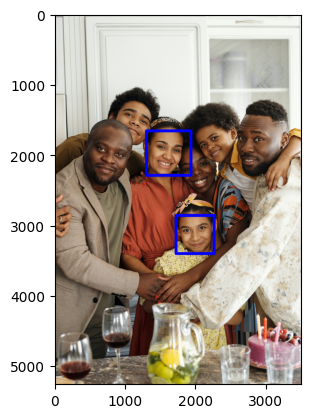

In [ ]:

#!pip install opencv-contrib-python

start = time.time()

# this is a pre-trained face cascade
test_image = cv2.imread('/content/drive/MyDrive/datasets/cv2/family.jpg')
face_cascade = cv2.CascadeClassifier('/content/drive/MyDrive/datasets/cv2/haarcascade_frontalface_default.xml')
faces = face_cascade.detectMultiScale(grey, 1.3, 5)
for (x,y,w,h) in faces:
     cv2.rectangle(test_image,(x,y),(x+w,y+h),(255,0,0),40)
plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))

print("Time taken:",end-start," seconds")
#print("Number of faces:",len(faces))

In [ ]:
"""from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier('/content/drive/MyDrive/datasets/cv2/haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier('/content/drive/MyDrive/datasets/cv2/haarcascade_eye.xml')

img = cv2.imread('/content/drive/MyDrive/datasets/cv2/family.jpg')

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

faces = face_cascade.detectMultiScale(gray, 1.3, 5)
#faces = face_cascade.detectMultiScale(gray)

for (x,y,w,h) in faces:
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    roi_gray = gray[y:y+h, x:x+w]
    roi_color = img[y:y+h, x:x+w]
    eyes = eye_cascade.detectMultiScale(roi_gray)
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(0,255,0),2)

cv2_imshow(img)
"""

Real-time FR solutions

In [ ]:
# taken from https://medium.com/@victormurcia-53351/real-time-facial-recognition-with-python-e5da50eb0349

In [ ]:
# FACE
def objectTracker1(cascPath):

    faceCascade = cv2.CascadeClassifier(cascPath)

    cv2.namedWindow("preview")
    vc = cv2.VideoCapture(0)

    while True: # try to get the first frame
        rval, frame = vc.read()
        # Capture frame-by-frame
        ret, frame = vc.read()

        #Convert frame to grayscale
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        objects = faceCascade.detectMultiScale(gray, scaleFactor=1.2,
                                               minNeighbors=1, minSize=(40, 40),
                                               flags=cv2.CASCADE_SCALE_IMAGE)
        # Draw a rectangle around the faces
        for (x, y, w, h) in objects:
            cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 0), 2)

        cv2.imshow("preview", frame)
        rval, frame = vc.read()
        key = cv2.waitKey(20)
        if key == 27: # exit on ESC
            break

    vc.release()
    cv2.destroyWindow("preview")

In [ ]:
# eyes and faces

def objectTracker2(facePath, eyePath):

    faceCascade = cv2.CascadeClassifier(facePath)
    eyeCascade  = cv2.CascadeClassifier(eyePath)
    cv2.namedWindow("preview")
    vc = cv2.VideoCapture(0)

    while True: # try to get the first frame
        rval, frame = vc.read()
        # Capture frame-by-frame
        ret, frame = vc.read()

        #Convert frame to grayscale
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        faces = faceCascade.detectMultiScale(gray, scaleFactor=1.2,
                                               minNeighbors=1, minSize=(40, 40),
                                               flags=cv2.CASCADE_SCALE_IMAGE)
        # Draw a rectangle around the faces
        for (x, y, w, h) in faces:
            cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 0), 2)
            #select face as region of interest
            roi_g =  gray[y:y+h,x:x+h]
            roi_c = frame[y:y+h,x:x+h]
            #within region of interest find eyes
            eyes = eyeCascade.detectMultiScale(roi_g)
            #for each eye
            for (ex,ey,ew,eh) in eyes:
                #draw retangle around eye
                cv2.rectangle(roi_c, (ex,ey),(ex+ew,ey+eh),(0,255,0),2)

        cv2.imshow("preview", frame)
        rval, frame = vc.read()
        key = cv2.waitKey(20)
        if key == 27: # exit on ESC
            break

    vc.release()
    cv2.destroyWindow("preview")